# The `Descriptor` class
When dealing with thinslices of sediment samples we face a few challenges: firstly, deposited layers may not always be oriented horizontally (e.g. if the core was taken at an angle or distortions occurred during sample preparation). Secondly, our classification so far is quite noisy and it is not clear where one layer ends and the next begins. 

We will start by addressing the first point. The package provides a way of correcting tilts by identifying angles along color gradients via the `Descriptor` class. We will use another image where it is obvious that a tilt correction is necessary (the *'tilted.bmp'* file). 

## Input for the `Descriptor`
First, let's get our image (the image file contains more than the sample region, which the descriptor can not take care off

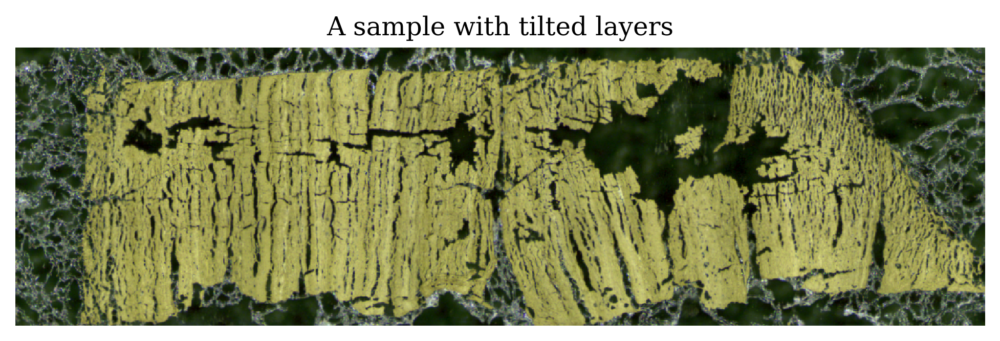

In [1]:
from maspim import ImageSample, plt_cv2_image
import PIL
import matplotlib.pyplot as plt
import numpy as np

path_image = r'Data\tilted.bmp'

sample = ImageSample(path_image_file=path_image)

# run the optimizer to get the sample area
image = sample.image_sample_area

%matplotlib inline
plt_cv2_image(image, title='A sample with tilted layers', no_ticks=True)

## Initializing the `Descriptor`
Now getting back to the descriptor. Upon initialization, you can make a few choices regarding the number of features that you want to use to describe the image. Our goal is to find the angles at each point in the image. The descriptor finds the best function that is step-shaped and described by a size, an angle, and a phase. We will look at a few examples

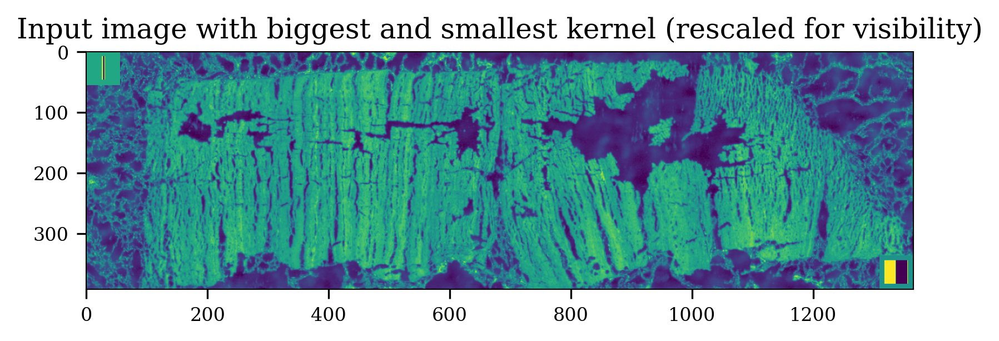

In [2]:
from maspim import Descriptor
descriptor = Descriptor(image=image, n_angles=8, n_sizes=4, n_phases=8)

descriptor.plot_kernel_on_img()

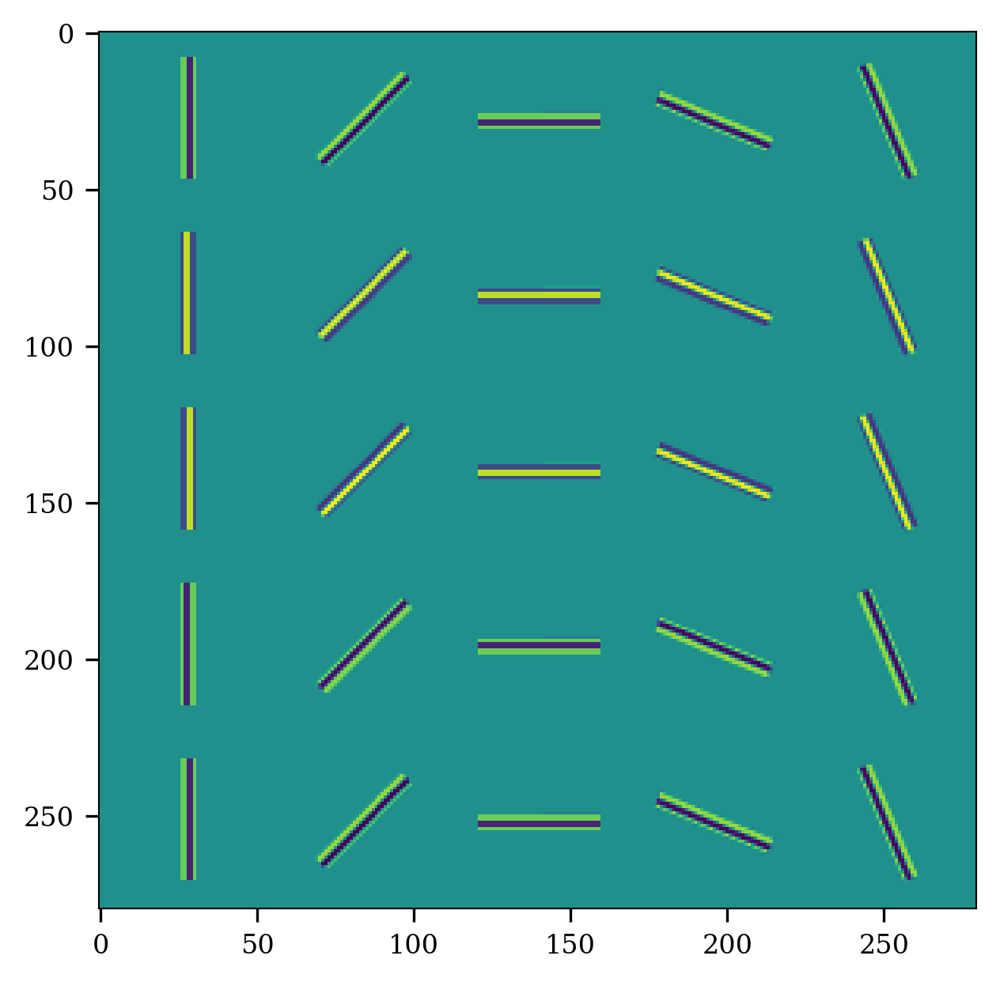

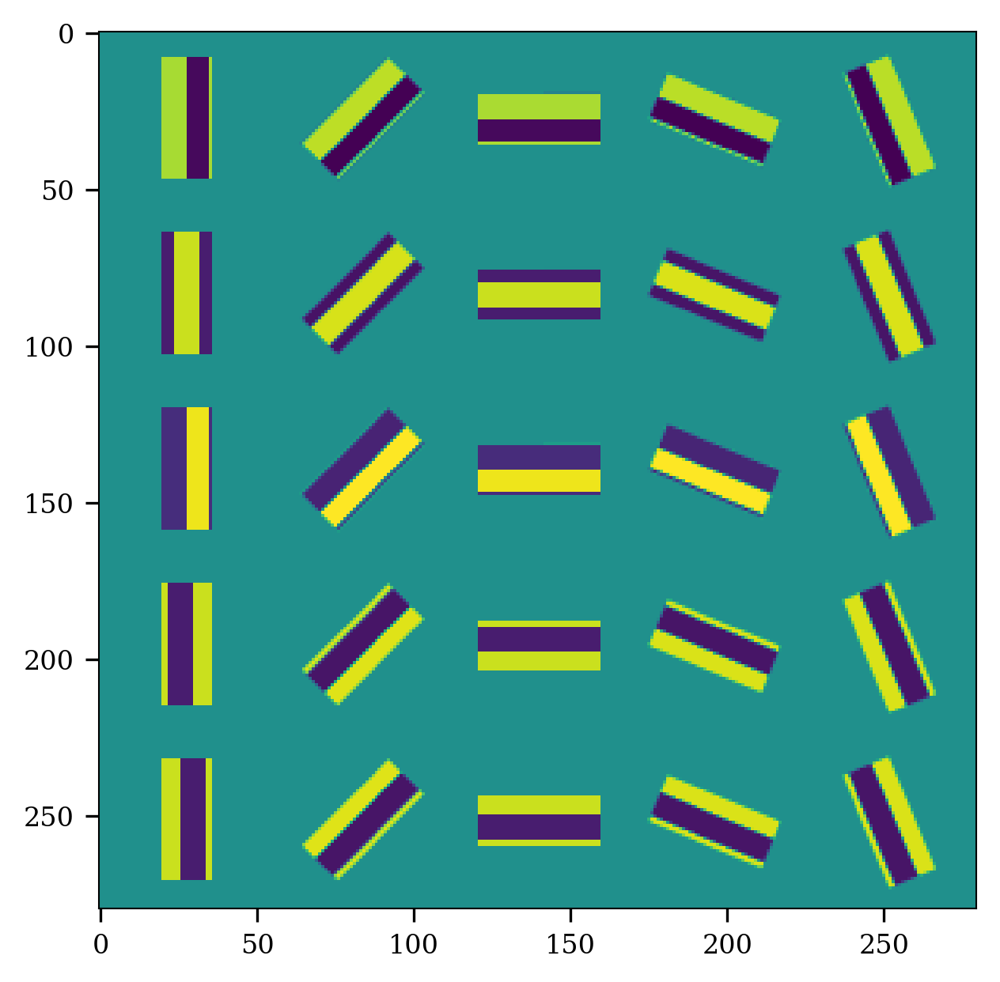

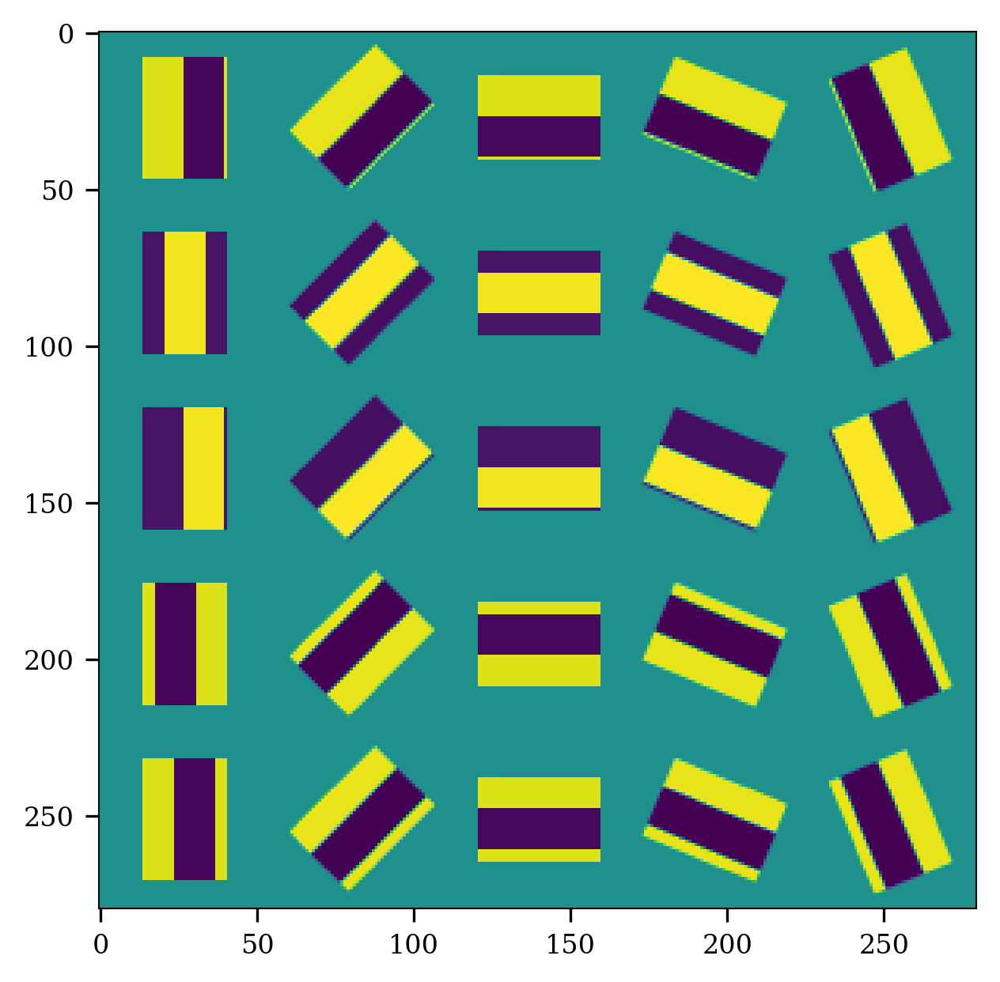

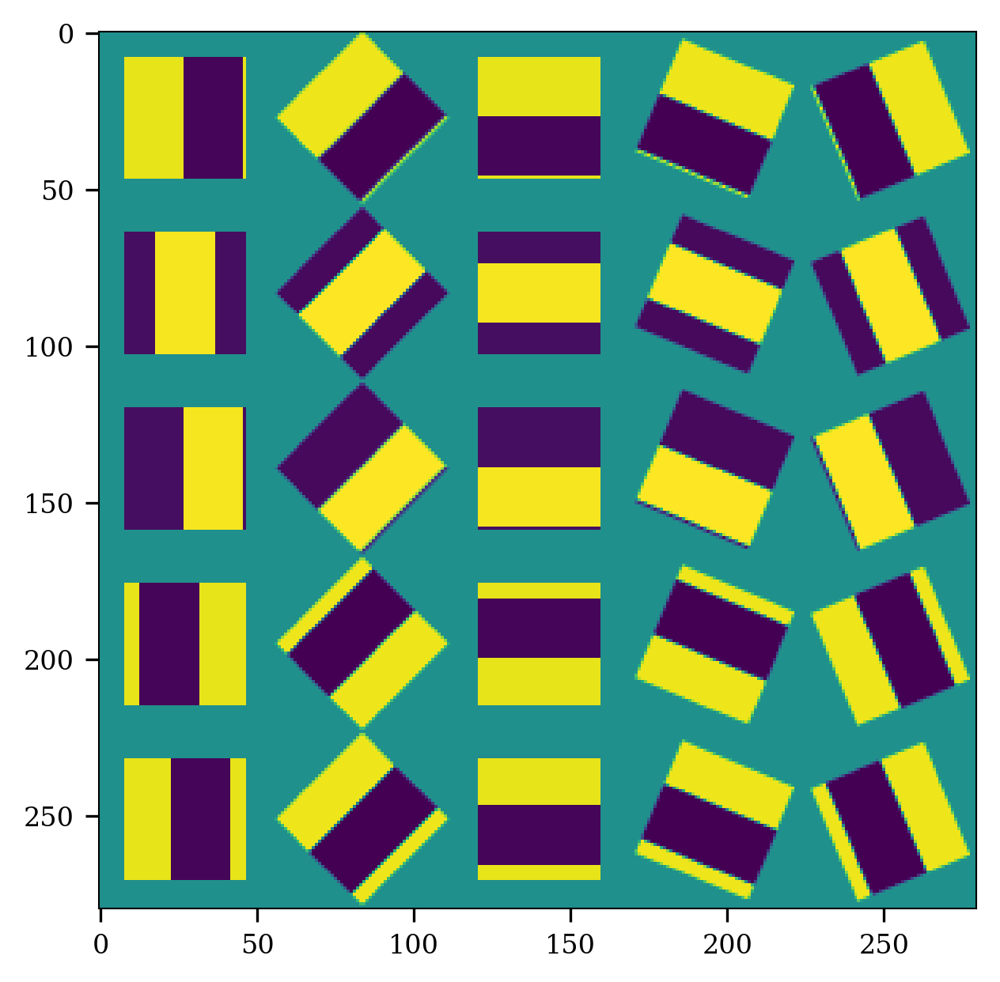

In [3]:
descriptor.plot_kernels()

* sizes increase from image to image
* angles increase from left (0 degrees) to right (180 degrees)
* phases increase from top (0 degrees) to bottom (360 degrees)
*n_angles, n_sizes*, and *n_phases* control how many kernels are used between interval bounds. It is important to find the right interval for the period. If max_period is too small, it is not possible to represent thick layers accurately, so make sure the smallest and largest kernel roughly match the thinnest and thickest layers respectively.

In this example the match is decent, but we could modify our inputs like this:

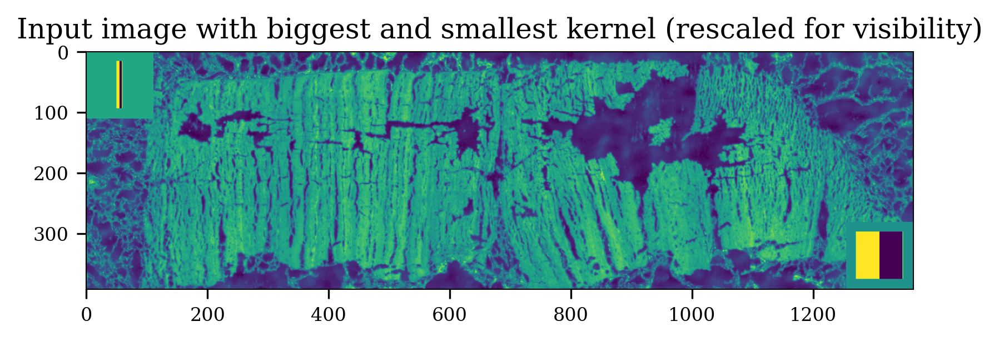

In [4]:
descriptor2 = Descriptor(
    image=image, 
    min_period=10,  # in terms of pixels
    max_period=.2  # in terms of vertical image extent
)

descriptor2.plot_kernel_on_img()

We will stick with the default parameters (so 32 angles, 8 sizes, 8 phases, a max_period of 0.1, and a min_period 10 times smaller than that. 

It is also important to consider how to handle background pixels. It is possible to provide a mask that defines foreground pixels. In that case, values for background pixels will be interpolated. By default, the background pixels are determined automatically using the Otsu filter.

## Initialization with custom mask

However, this may not always be desirable, since the extent of holes may (and often does) follow structures and is useful information to include. In that case provide *mask=np.ones(image.shape[:2])* (all pixels are to be considered foreground pixels)

In [5]:
descriptor = Descriptor(image=image, mask=np.ones(image.shape[:2]))

a mask was provided, but use_mask is set to False. This will ignore the mask. In order to use the mask, set use_mask=True


## Using the descriptor to detect tilted layers
As mentioned before, the `Descriptor` finds the best kernel match for each pixel. Since kernels have an angle parameter, we also get information about the angle for every pixel (alongside the width and phase)

### Determining kernel parameters

In [6]:
descriptor.set_conv()

searching parameters: 100%|██████████████████████████████████████████████████████████████| 8/8 [00:31<00:00,  3.94s/it]


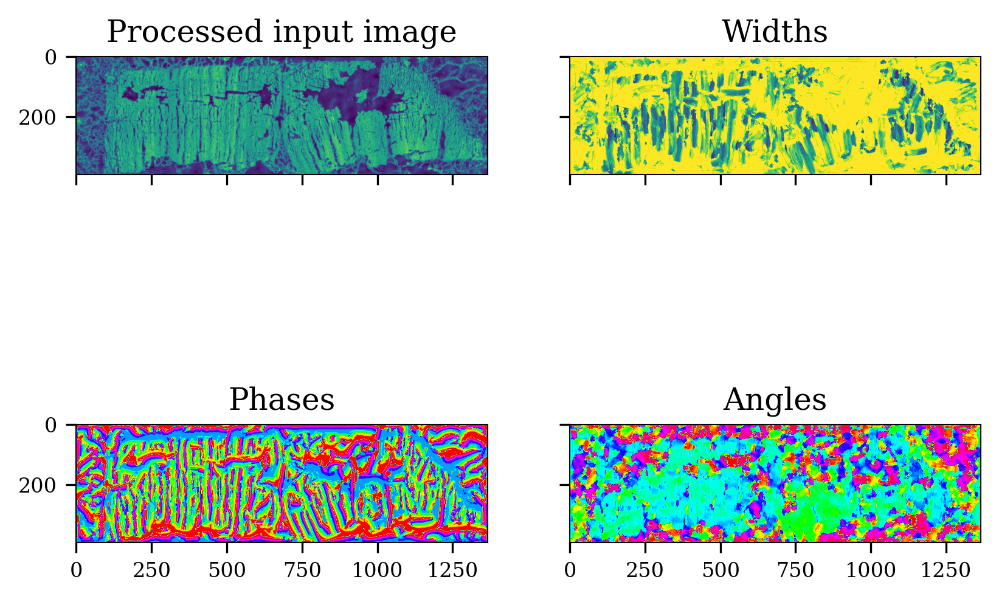

In [7]:
descriptor.plot_parameter_images()

### Postprocessing kernel parameters
Alright, this already looks promising. Notice how the angles in the tilted sections vary in color. One big issue, however, is the noisyness of the classified angles. This has to be expected since the image itself is noisy. We will address this in two steps: first, we disregard any pixels that are obviously not part of a layer. Candidates are pixels with angles above 45 degrees. They are most likely caused by steep brightness gradients at the boundaries of the sediment. Also, background pixels will be filtered out by default. For the filtering, the parameters you may want to take into consideration are
* `n_footprint`: footprint size (in pixels) for a modal filter to smooth angle values (default is 1, which results in no smoothing)
* `interpolate`: whether to interpolate disregarded pixels or leave them at 0, default is `False`
* `angle_min`: minimum angle allowed, default is $-\pi / 4$ or $-45^\circ$ (angles are measured counterclockwise from the horizontal axis)
* `angle_max`: maximum angle allowed, default is $\pi / 4$ or $45^\circ$
* `mute_bounds`: what section to disregard at the top and bottom of the image (default is 0, must be a value between 0 and 1/2)

It is common for image feature extraction algorithms to combine information from areas into cells. The approach taken from this class is inspired by the [histogram of oriented gradients](https://en.wikipedia.org/wiki/Histogram_of_oriented_gradients) descriptor: we bin angles into cells and take a weighted average of angles in each cell. Angles are taken to be defined at the weighted center of each cell. Values between cell centers are interpolated. The weights are the results of the convolution with kernels, more specifically the highest value seen across all kernels. This can be interpreted as a measure for the quality of lamination: clear lamination should be captured well by step-wise kernels.

Here, the parameters are
* `ny_cells`: the number of cells in the vertical direction for binning the angles (default is 10)
* `n_seeds`: number of streamlines between which angle values are interpolated (default is 100)
Now, that's quite many parameters. We'd recommend sticking to the default values unless you have a strong reason to believe otherwise. The most important parameters are `ny_cells` and the angle boundaries, as we will see below. Here it is usually worth exploring a few options between 3 and 50.

All those parameters are optional keyword arguments for the `fit` method. We will explore a few `ny_cells` values and leave the rest at the default values

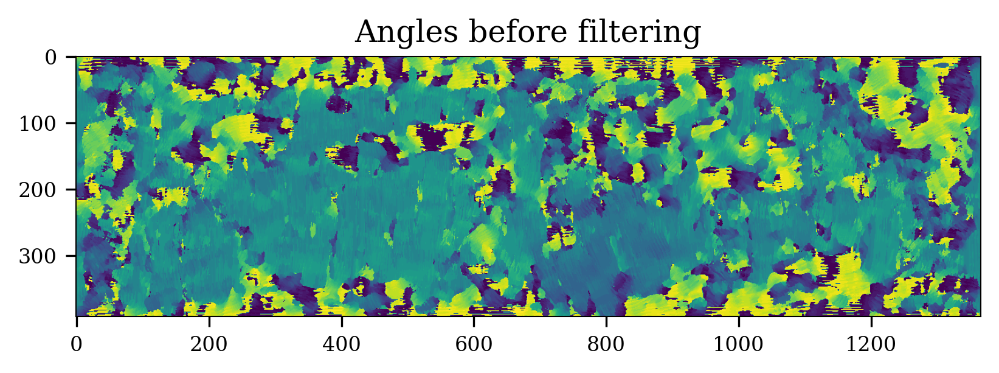

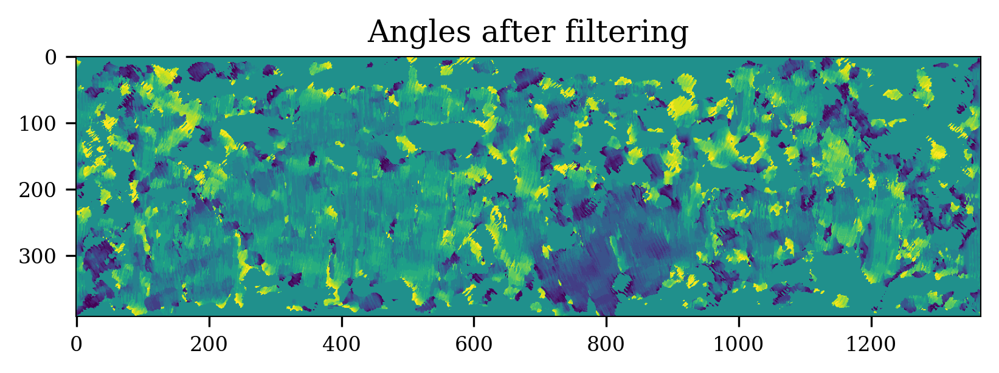

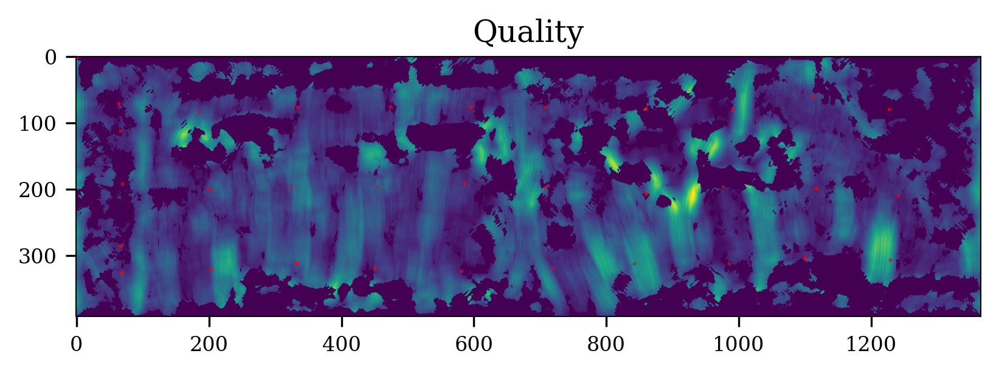

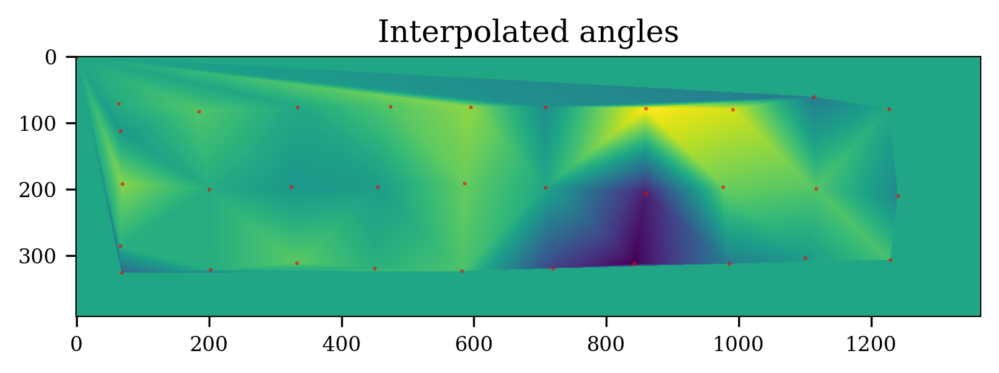

setting deformation field from streamlines: 100%|██████████████████████████████████| 100/100 [00:00<00:00, 5841.73it/s]


In [8]:
descriptor.fit(ny_cells=3, plts=True)

In the first two images, you can see the angle filter at work, angles with strong colors (meaning extreme angles) are missing in the second image. The third image shows the qualities and determined cell centers as red dots. In the last figure, the interpolated angles are shown. From that, it should already be apparent that the number of cells is too low, but let's look at the resulting corrected image nonetheless:

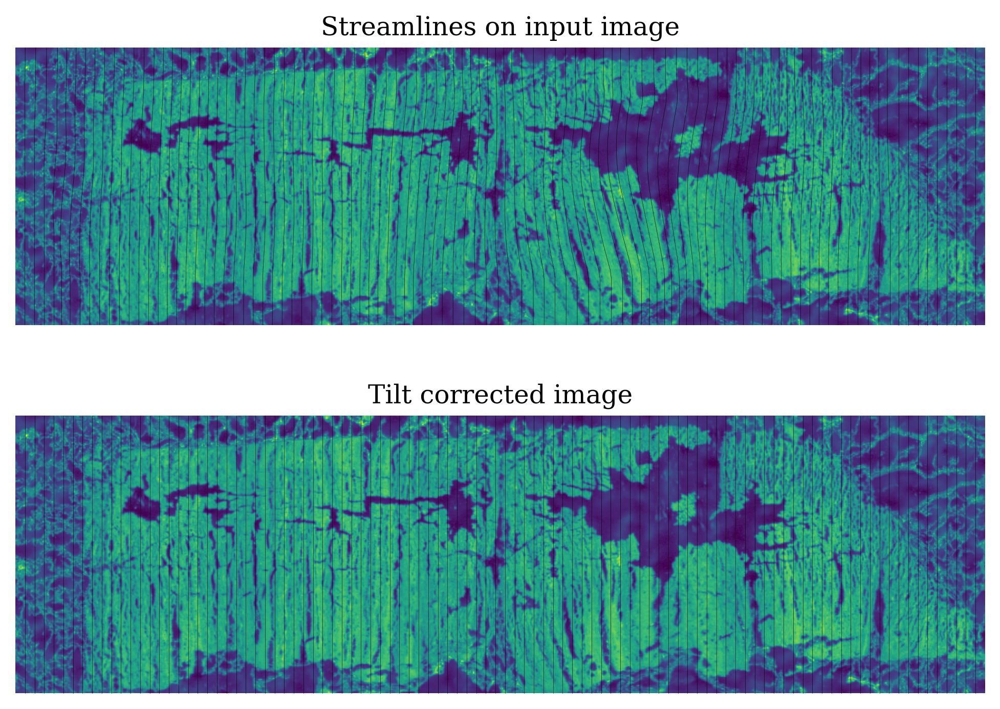

In [9]:
descriptor.plot_corrected()

The first figure shows the input image together with the `n_seeds=100`  streamlines (determined from the interpolated angles). Ideally, the streamlines would be parallel to sediment layers. We can see that this is oftentimes not the case, especially for tilted layers because our cells are too coarse. In the second image, the streamlines are all vertical lines because the input image is shifted accordingly.

So let's see what we get for more cells:

setting deformation field from streamlines: 100%|█████████████████████████████████| 100/100 [00:00<00:00, 14861.30it/s]


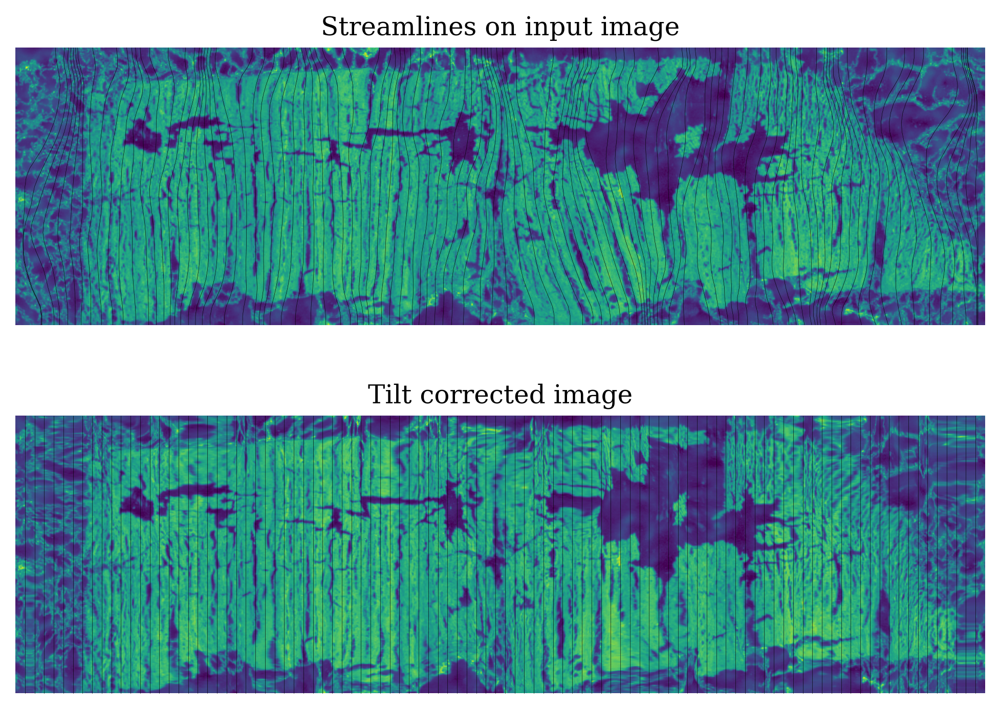

In [10]:
descriptor.fit(ny_cells=10)
descriptor.plot_corrected()

This is closer to what we want. However, now you can see another issue arising, which is unrealistic distortions in areas where the density of streamlines varies strongly. Currently, there is no solution around that, except for varying the parameters mentioned above and praying for the best. Although you may be already able to guess that more cells won't improve the result, let's see what happens with 20 cells

setting deformation field from streamlines: 100%|█████████████████████████████████| 100/100 [00:00<00:00, 14258.58it/s]


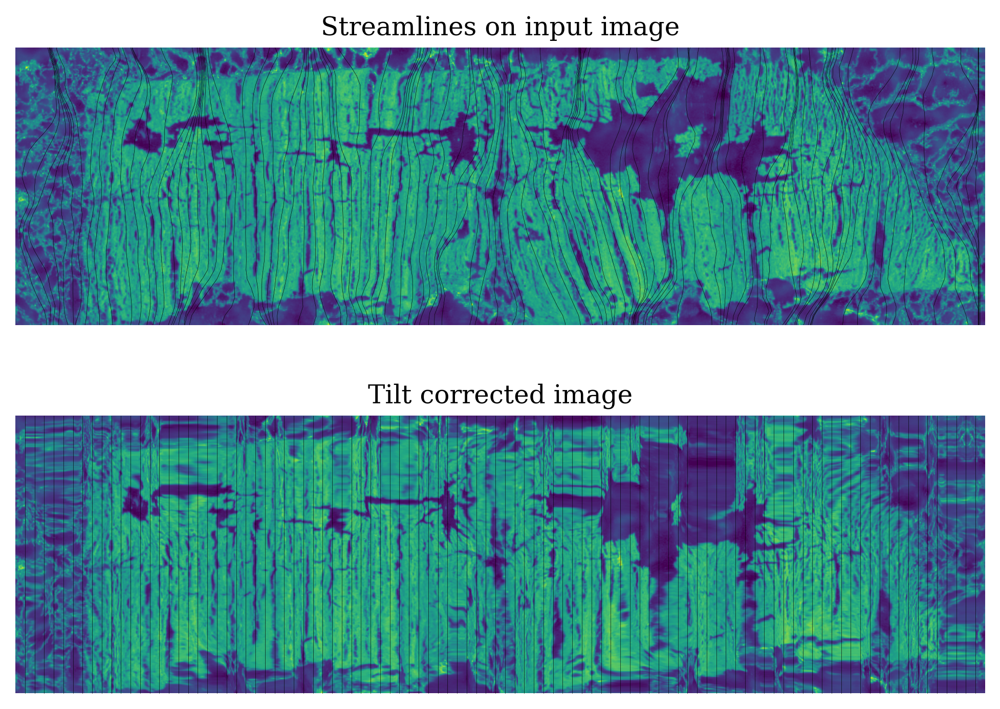

In [11]:
descriptor.fit(ny_cells=20)
descriptor.plot_corrected()

### Exploring the use of masks
Oftentimes this change in density occurs at sediment-background transitions, so let's see what happens if we use a mask upon initialization:

setting deformation field from streamlines: 100%|█████████████████████████████████| 100/100 [00:00<00:00, 14282.37it/s]


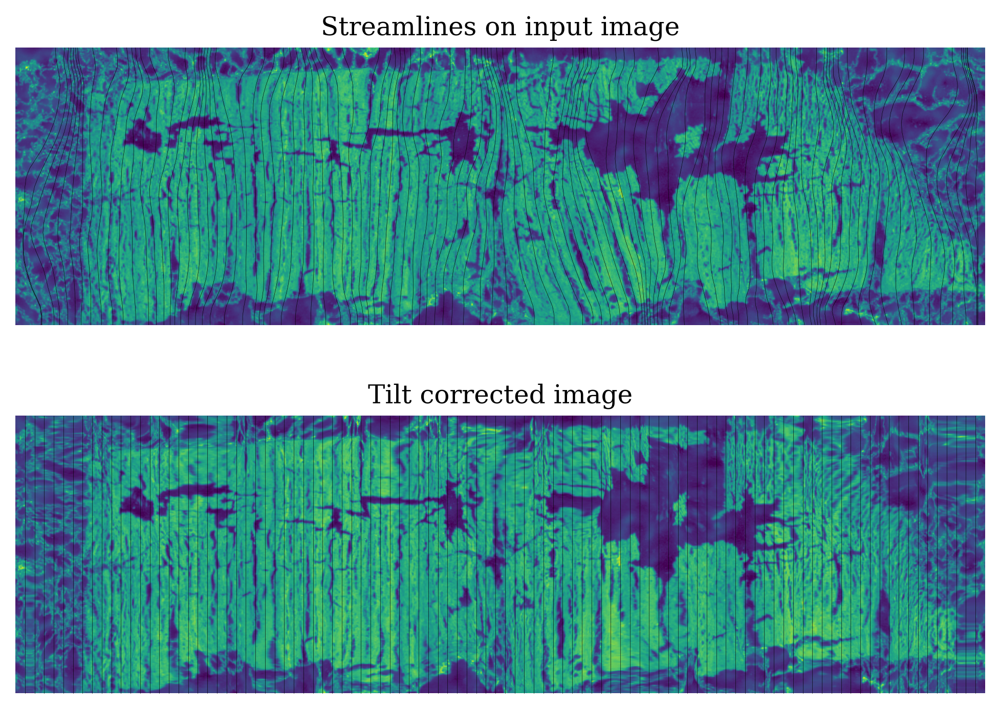

In [12]:
descriptor_mask = Descriptor(image=image)
descriptor_mask.set_conv()
descriptor_mask.fit(ny_cells=10)
descriptor_mask.plot_corrected()

Compared to the result with 10 cells from above this actually does not look too different. 

### Fine-tuning the parameters
As previously mentioned, we are restricting the angles from -45 to 45 degrees. We can guess from the image that our tilt angles in the most extreme case are actually lower than that, so maybe let's restrict the values to the interval [-22.5, 22.5]

setting deformation field from streamlines: 100%|█████████████████████████████████| 100/100 [00:00<00:00, 13329.21it/s]


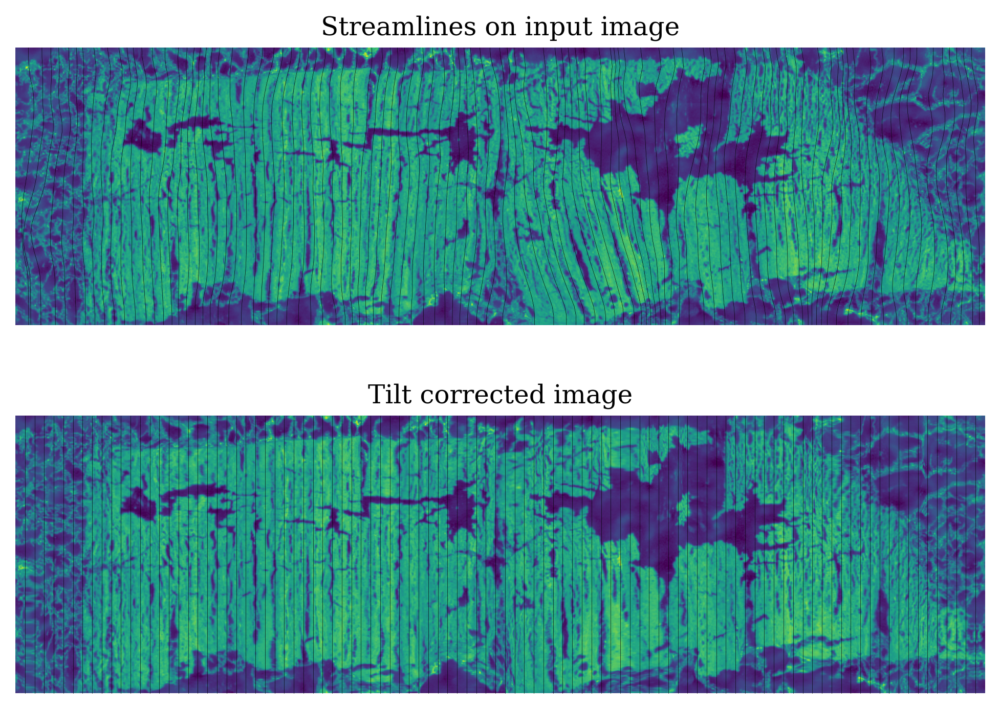

In [13]:
import math
descriptor.fit(ny_cells=10, angle_min=math.radians(-22.5), angle_max=math.radians(22.5))
descriptor.plot_corrected()

Ok, now that looks reasonable. 

## Saving the descriptor
One final step remains, which is to save the transformation defined by the descriptor for later use. Throughout this pipeline, the `Mapper` class is used to save any type of image transformation, which defines deformation vectors for each pixel (for a transformation that leaves the image shape unchanged, one can always define a transformation like this). We can use the `get_mapper` method to initialize a `Mapper` instance and then save it. Don't worry about the details as we will create a new transformation from the `ImageClassified` class directly, that takes care of the file paths and names, but we can look at the defined deformation field.

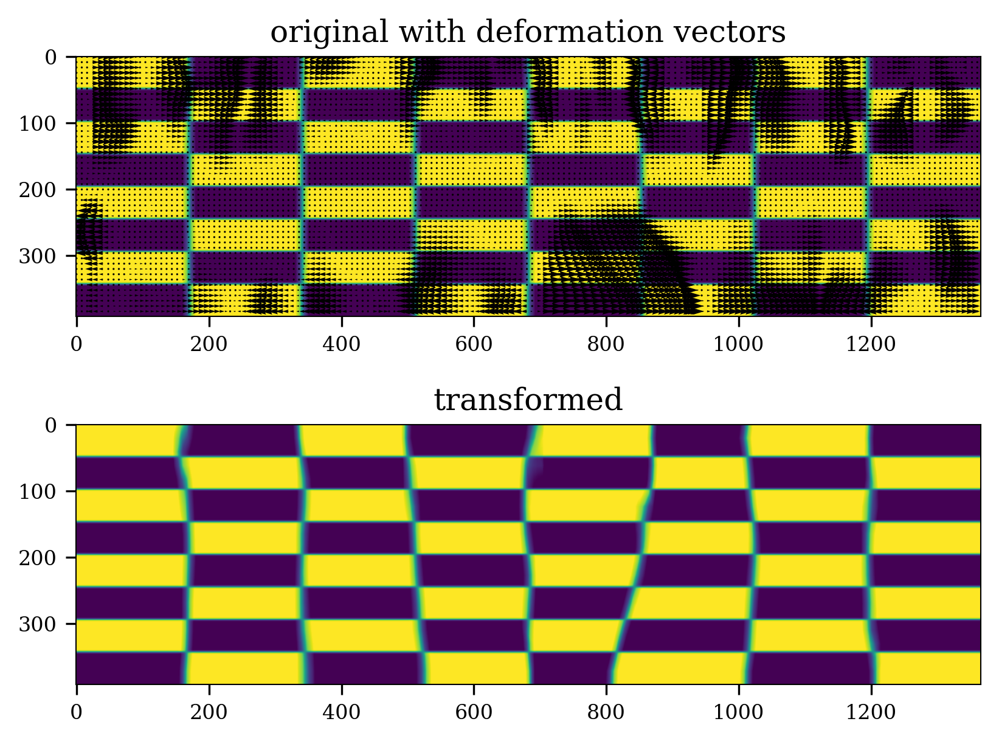

In [14]:
path_mapper = 'Data'
mapper = descriptor.get_mapper(path_folder=path_mapper)
mapper.plot_overview()
# this would save the mapper inside the Data folder
# mapper.save()

Notice how deformations are only defined along the horizontal axis. The vectors define the backward deformation (so from the tilt-corrected image to the input image). The diagonal line around 800 is quite pronounced in the transformed image. If you compare it to the input image above, you will notice that the slope is in the opposite direction, as it should be when we are correcting tilts. 


## using the `Project` class
You can also conveniently evoke a `Descriptor` from a `Project` instance with `project.set_corrected_image` (where `project` is the `Project` instance), providing any of the optional parameters discussed above.